## Project Objective

The goal of this Project is to apply data manipulation, visualization, and machine learning 
techniques to create models and generate actionable insights from a real-world dataset.

### Introduction to the Dataset

### Spotify Dataset
This dataset contains Spotify track audio features across 125 genres in tabular CSV format


Below are the details of the columns this dataset contains:
<br>
**track_id**: The Spotify ID for the track<br>
**artists**: The artists' names who performed the track. If there is more than one artist, they are separated by a ;<br>
**ablum_name**: album name in which the track appears<br>
**track_name**: Name of the track<br>
**popularity**: The popularity of a track is a value between 0 and 100, with 100 being the most popular. The popularity is calculated by algorithm and is based, in the most part, on the total number of plays the track has had and how recent those plays are. Generally speaking, songs that are being played a lot now will have a higher popularity than songs that were played a lot in the past. Duplicate tracks (e.g. the same track from a single and an album) are rated independently. Artist and album popularity is derived mathematically from track popularity. <br>
**duration_ms**: The track length in milliseconds<br>
**explicit**: Whether or not the track has explicit lyrics (true = yes it does; false = no it does not OR unknown)<br>
**danceability**: Danceability describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity. A value of 0.0 is least danceable and 1.0 is most danceable<br>
**energy**: Energy is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale<br>
**key**: The key the track is in. Integers map to pitches using standard Pitch Class notation. E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on. If no key was detected, the value is -1<br>
**loudness**: The overall loudness of a track in decibels (dB)<br>
**mode**: Mode indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0<br>
**speechiness**: Speechiness detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value. Values above 0.66 describe tracks that are probably made entirely of spoken words. Values between 0.33 and 0.66 describe tracks that may contain both music and speech, either in sections or layered, including such cases as rap music. Values below 0.33 most likely represent music and other non-speech-like tracks<br>
**acousticness**: A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic<br>
**instrumentalness**: Predicts whether a track contains no vocals. "Ooh" and "aah" sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly "vocal". The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content<br>
**liveness**: Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live. A value above 0.8 provides strong likelihood that the track is live<br>
**valence**: A measure from 0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry)<br>
**tempo**: The overly estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece and derives directly from the average beat duration<br>
**time_signature**:An estimated time signature. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure). The time signature ranges from 3 to 7 indicating time signatures of 3/4, to 7/4.<br>
**track_genre**: The genre in which the track belongs
hich the track belongs
: The genre in which the track belongs

(Pandya, 2023)

## Business Objective to be achieved

The objective of this notebook is to identify with the help of available information if the song is of mode 'Minor' or 'Major'.

Mode indicates the modality (major or minor) of a track. Each modality is connected with different human emaotions.<br>
**Major** scales are generally associated with positive emotions like Happiness, grace, serenity and solemnity.<br>
**Minor** scales typically convey feelings like Sadness, anger, dreaminess, tenseness, suffering.
<br>(Chase, 2006)
<br>

Identifying the mode will help the spotify's recommendation system to recommend songs which has a similar mode as the songs the user is listening in his current session..

### Steps followed to achieve the above objective
1. Importing libraries
2. Converting the dataset to a Dataframe
3. Data Cleaning
4. Analysing the Dataset (summarized view of the data)
5. Data Visualisation
6. Data Preprocessing/Transformation for Model learning
7. Models Creation
8. Hypertuning the best model
9. Saving the models to a pickle file
10. Sample to Load the model and predicting value using the same
11. Recommendation
12. References


### Importing Libraries

Below, libraries are installed which will be required in the further steps.

In [1]:
#Importing important libraries
#pandas and numpy
import pandas as pd
import numpy as np

# visualisation libraries
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

#data preprocessing libraries
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.preprocessing import MinMaxScaler

# Machine learning model related libraies
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,confusion_matrix,precision_score,recall_score,f1_score
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV,validation_curve,ValidationCurveDisplay


#pickle to save the models
import pickle

#to remove warning texts from notebook
import warnings
warnings.filterwarnings('ignore')

### Converting the dataset to a Dataframe

In [2]:
#Inporting the data using pandas
df=pd.read_csv('spotify-dataset.csv')
#checking a sample from the data i.e top 5 rows
df.head()

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


In [3]:
#Checking the columns names of the data
print('Column names:')
print(df.columns)

Column names:
Index(['Unnamed: 0', 'track_id', 'artists', 'album_name', 'track_name',
       'popularity', 'duration_ms', 'explicit', 'danceability', 'energy',
       'key', 'loudness', 'mode', 'speechiness', 'acousticness',
       'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature',
       'track_genre'],
      dtype='object')


### Data Cleaning

From the above data, we can clearly see that it contains an extra column named 'Unnamed:0' which needs to be removed.
Below are the process that will be performed in the below code:
1. Removing unnamed column
2. Checking for NA values and removing if any
3. Removing duplicate rows if any

In [4]:
#dropping the first column as it's not of any use
df=df.drop("Unnamed: 0",axis=1)

In [5]:
#Checking for null value
df.isna().sum()

track_id            0
artists             1
album_name          1
track_name          1
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

In [6]:
# Checking the row with NA value before removing it
df[df['artists'].isna()]

,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
65900,1kR4gIb7nGxHPI3D2ifs59,NaN,NaN,NaN,0,0,False,0.501,0.583,7,-9.46,0,0.0605,0.69,0.00396,0.0747,0.734,138.391,4,k-pop


In [7]:
# Removing NA rows
clean_df=df.dropna(axis=0)

In [8]:
#Checking for duplicate values
print('Number of Duplicate rows:')
clean_df.duplicated().sum()

Number of Duplicate rows:


450

In [9]:
# Removing duplicate rows
clean_df=clean_df.drop_duplicates().reset_index(drop=True)
# checking the final length of the dataframe after NA and duplicate values removal
print('Number of remaining rows are:')
len(clean_df)

Number of remaining rows are:


113549

### Analysing the Dataset (summarized view of the data)

In [10]:
# describing the numerical columns of data 
clean_df.describe()

,popularity,duration_ms,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
count,113549.000000,1.135490e+05,113549.000000,113549.000000,113549.000000,113549.000000,113549.000000,113549.000000,113549.000000,113549.000000,113549.000000,113549.000000,113549.000000,113549.000000
mean,33.324433,2.280814e+05,0.567031,0.642091,5.309452,-8.243408,0.637866,0.084674,0.314064,0.155703,0.213613,0.474205,122.175745,3.904218
std,22.283855,1.064131e+05,0.173409,0.251053,3.560147,5.011422,0.480620,0.105762,0.331906,0.309217,0.190462,0.259204,29.972954,0.432117
min,0.000000,8.586000e+03,0.000000,0.000000,0.000000,-49.531000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,17.000000,1.741840e+05,0.456000,0.473000,2.000000,-9.998000,0.000000,0.035900,0.016800,0.000000,0.098000,0.260000,99.296000,4.000000
50%,35.000000,2.130000e+05,0.580000,0.685000,5.000000,-6.997000,1.000000,0.048900,0.168000,0.000041,0.132000,0.464000,122.020000,4.000000
75%,50.000000,2.615880e+05,0.695000,0.854000,8.000000,-5.001000,1.000000,0.084500,0.596000,0.048700,0.273000,0.683000,140.074000,4.000000
max,100.000000,5.237295e+06,0.985000,1.000000,11.000000,4.532000,1.000000,0.965000,0.996000,1.000000,1.000000,0.995000,243.372000,5.000000


In [11]:
#ckecking unique values of all columns to find potential categorical columns
print('Unique values in each columns')
print('-----')
#empty list to store unique values
uniques=[]
for i in clean_df.columns:
    uniques.append(len(clean_df[i].unique()))
#creating dataframe from the column names and the valued
unique_df=pd.DataFrame(zip(list(clean_df.columns),uniques),columns=['Column_names','Unique values'])
unique_df

Unique values in each columns
-----


,Column_names,Unique values
0,track_id,89740
1,artists,31437
2,album_name,46589
3,track_name,73608
4,popularity,101
5,duration_ms,50696
6,explicit,2
7,danceability,1174
8,energy,2083
9,key,12


In [12]:
#checking the data type of the columns
clean_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113549 entries, 0 to 113548
Data columns (total 20 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   track_id          113549 non-null  object 
 1   artists           113549 non-null  object 
 2   album_name        113549 non-null  object 
 3   track_name        113549 non-null  object 
 4   popularity        113549 non-null  int64  
 5   duration_ms       113549 non-null  int64  
 6   explicit          113549 non-null  bool   
 7   danceability      113549 non-null  float64
 8   energy            113549 non-null  float64
 9   key               113549 non-null  int64  
 10  loudness          113549 non-null  float64
 11  mode              113549 non-null  int64  
 12  speechiness       113549 non-null  float64
 13  acousticness      113549 non-null  float64
 14  instrumentalness  113549 non-null  float64
 15  liveness          113549 non-null  float64
 16  valence           11

##### Insights from the above data summarization
- track_id, artists, album_name and track_name are string values which are not categorical. We won't be able to use it while creating creating the model.
- Although explicit is in bool and track_genre is string, it has less number of unique values which can help in the model. But this data needs to be converted to numerical.
- rest all the columns are numerical

From the insights gained above, below we convert the categorical values to numerical values

In [13]:
# Converting bool values from the explicit column to numerical values
clean_df['explicit']=[int(i) for i in clean_df['explicit']]
#converting the track_genre column to numerical values and storing the value equivalent in the genre_dict variable
clean_df['track_genre'],genre_dict=pd.factorize(clean_df['track_genre'])

Now the data is cleaned and all the columns are in the required data type.

## Data Visualisation

Below we visualise the data to make some insights to understand the data a bit better

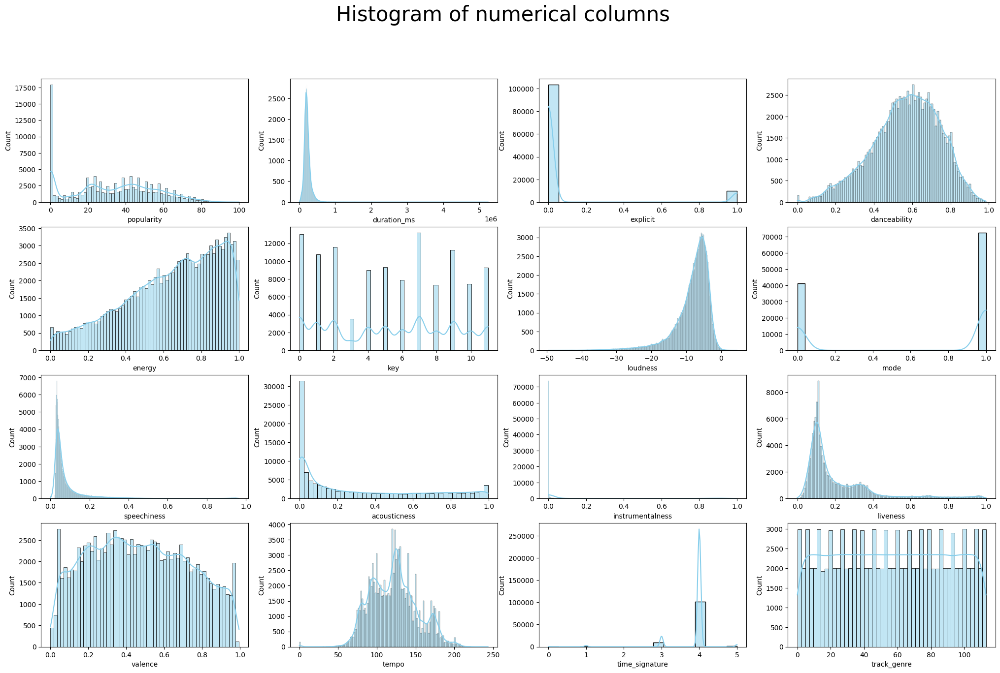

In [14]:
# creating histogram charts for all the numeric
#creating subplots areas to accomodate 16 charts for 16 numerical columns
fig, axs = plt.subplots(4, 4, figsize=(25, 15))
cnt=4

# Creating charts at all the subplot areas
for i in range(4):
    for j in range(4):
        # Creating histogram
        sns.histplot(data=clean_df, x=clean_df.columns[cnt], kde=True, color="skyblue", ax=axs[i, j])
        cnt=cnt+1
        
# Setting title for the complete subplot
plt.suptitle('Histogram of numerical columns',fontsize=30)
plt.show()

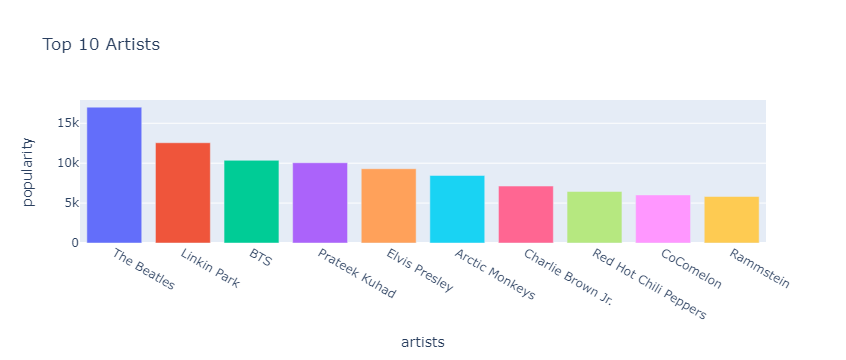

In [15]:
# Creating dataframe for top 10 popular artists
top_10_artists=clean_df.groupby('artists',as_index=False).sum().sort_values('popularity',ascending=False).head(10)

# Plotting the dataframe to a bar chart
fig=px.bar(top_10_artists,x='artists',y='popularity',title='Top 10 Artists',height=500,color='artists')
fig.update_layout(showlegend=False)

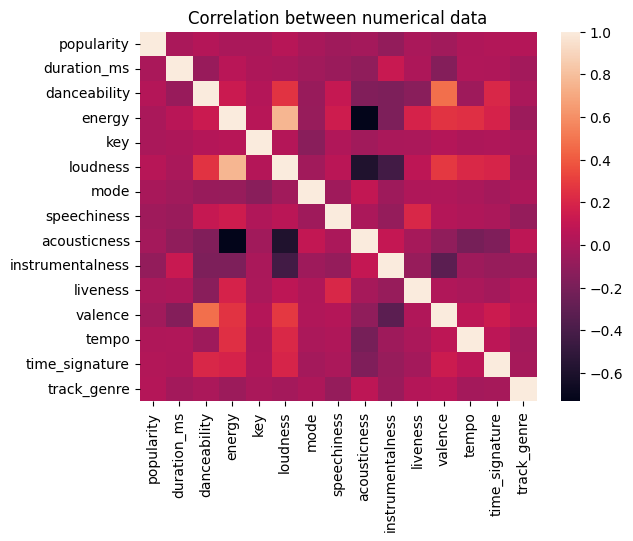

In [16]:
#correlation between the numerical data
a=clean_df[['popularity','duration_ms','danceability','energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature','track_genre']].corr()

#Plotting the correlation data
ax=plt.axes()
sns.heatmap(a,ax=ax)
ax.set(title="Correlation between numerical data")
plt.show()

From the above correlation data, we can see their are some variables that are positively or negatively correlated to an another variable. Below are the highly correlated variable combinations:
- acousticness is negatively correlated with energy
- acousticness is negatively correlated with loudness
- energy is positively correlated with loudness

Let's see that correlation through scatter plot.

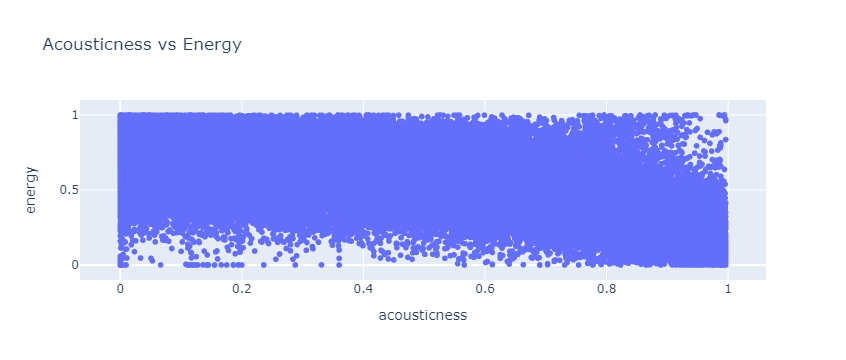

In [17]:
# scatter plot for acousticness vs energy
px.scatter(clean_df,x='acousticness',y='energy',height=600,title='Acousticness vs Energy')

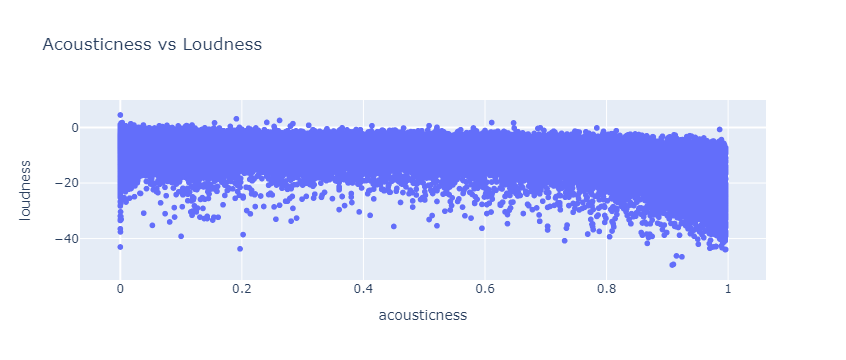

In [18]:
# scatter plot for acousticness vs loudness
px.scatter(clean_df,x='acousticness',y='loudness',height=600,title='Acousticness vs Loudness')

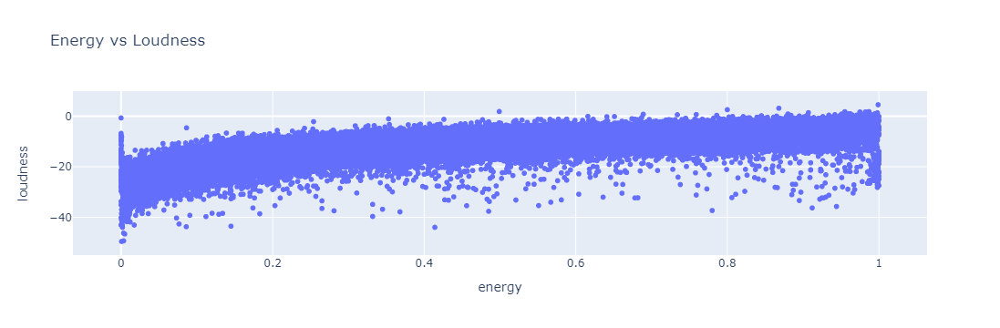

In [19]:
# scatter plot for energy vs loudness
px.scatter(clean_df,x='energy',y='loudness',height=600,title='Energy vs Loudness')

#### As our main target variable is Mode, let's visualise the mode variable

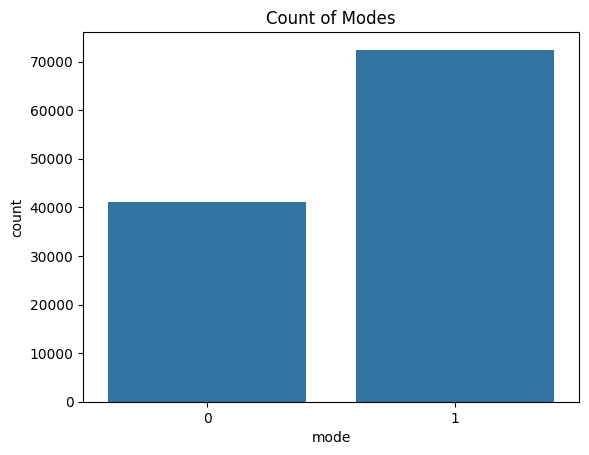

In [20]:
# Creating a bar plot for major(1) and minor(0) mode category
mode_count_fig=sns.countplot(clean_df,x='mode').set(title='Count of Modes')

From the above plot you can easily identify that occurance of different cateogry of mode is unbalanced.
Below is the percentage of occurance of each category:
- **0 (Minor)** : 36.2%
- **1 (Major)** : 63.8%

As the degree of imbalance is **mild** (Google Developers, n.d.), we'll move forward with the preprocessing steps

## Data Preprocessing/Transformation for Model learning
In this step we'll preprocess the data so that it can be used while creating model.
below are the preprocessing steps that'll be performed on the data:
- Storing independent and dependent variables seperately
- Stadardizing the data
- Principal component analysis (PCA) for dimension reduction to 2
- Finding the top 10 relavent features using chi square.

 #### Storing independent and dependent variables seperately

In [21]:
# Storing independent and dependent/ target data into different variables
x=clean_df[['duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness',
    'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature','popularity','track_genre']]
y=clean_df['mode']

#### Stadardizing the data

Let's standardize features by removing the mean and scaling to unit variance

In [22]:
# standardizing the independent variables
fin_x=StandardScaler().fit_transform(x)

#### Principal component analysis (PCA)
Principal component analysis for dimension reduction to 2 variables

In [23]:
# Creating an object for PCA
pca=PCA(n_components=2)
# fitting the independent variables to reduce the variables to 2
pca_arr=pca.fit_transform(fin_x)
# creating a dataframe with pca variables and dependent variable i.e. y
pca_df=pd.DataFrame(pca_arr,columns=['PCA1','PCA2'])
final_df=pd.concat([pca_df,y],axis=1)

Let's view the data before moving forward

In [24]:
# top 5 rows of the dataframe
final_df.head(5)

,PCA1,PCA2,mode
0,-0.694491,-0.787449,0
1,3.185058,-1.181706,1
2,1.325233,0.340238,1
3,3.722964,0.544003,1
4,0.867357,-0.129998,1


#### Finding the top 10 relavent features using chi square.

In [25]:
# Create an object of the top 10 variables with best scores based on chi square
bestfeatures = SelectKBest(score_func=chi2, k=10)
# Transforming the data to a range for finding relevent scores
sc = MinMaxScaler()
x_sr = sc.fit_transform(x)
# using the bestfeatures object, finding the top variables by using the porcessed independent variables and dependent variable
fit = bestfeatures.fit(x_sr,y)
# Creating a dataframe to store the socres with it's relevent column names
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(x.columns) 
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns

# taking the variables with top 10 highest scores 
top_variables_df=featureScores.nlargest(10,'Score')  #print 10 best features
print('Top 10 features:')
print(top_variables_df)
top_f_df=clean_df[list(top_variables_df['Specs'])]

Top 10 features:
               Specs       Score
4                key  454.912557
7       acousticness  372.755324
8   instrumentalness  179.849380
1           explicit  145.130371
3             energy   70.145591
6        speechiness   34.004947
2       danceability   29.769820
10           valence    7.412293
13        popularity    3.811462
9           liveness    3.725858


Now we have the processed data, let move towards creating the models, comparing their scores and selecting the best model.

## Models Creation

We'll use 4 different machine larning algorithms to create models
1. Logistic Regression
2. Random Forrest
3. Naive Bayes
4. K nearest neighbours

Currently we have 4 different dataframes which we'll use in each model to identify which dataset provides the best accuracy along with other scores.
1. all the features/independent variables in it's original state
2. top 10 features/independent variables in it's original state
3. all the features/independent variables in it's standardized state
4. dimensions reduced to 2 using PCA

Below we create different models using the created dataframes.


Before creating a model, below we create a dataframe which will store the scores of all the models which will help us to compare

In [26]:
# Creating dataframe to store scores of models
model_scores=pd.DataFrame([],columns=['Model_type','Model_no','Accuracy','Precision','Recall','F1_Score'])

### Logistic Regression

In [27]:
print('Logistic Regression Models')
print("Model 1: With all the features/independent variables in it's original state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(x,y , test_size=0.33, random_state=42)
# creating a model object
LR_model_1=LogisticRegression(max_iter=3000)
# fitting the model according to the data
LR_model_1.fit(X_train,y_train)
#predicting the values of test data
y_pred=LR_model_1.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
# printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['Logistic Regression',1,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 2: With top 10 features/independent variables in it's original state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(top_f_df,y, test_size=0.33, random_state=42)
# creating a model object
LR_model_2=LogisticRegression(max_iter=3000)
# fitting the model according to the data
LR_model_2.fit(X_train,y_train)
#predicting the values of test data
y_pred=LR_model_2.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
# printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['Logistic Regression',2,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 3: With all the features/independent variables in it's standardized state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(fin_x,y , test_size=0.33, random_state=42)
# creating a model object
LR_model_3=LogisticRegression(max_iter=3000)
# fitting the model according to the data
LR_model_3.fit(X_train,y_train)
#predicting the values of test data
y_pred=LR_model_3.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
# printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['Logistic Regression',3,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 4: With dimensions reduced to 2 using PCA")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(final_df.drop('mode',axis=1),y , test_size=0.33, random_state=42)
# creating a model object
LR_model_4=LogisticRegression(max_iter=3000)
# fitting the model according to the data
LR_model_4.fit(X_train,y_train)
#predicting the values of test data
y_pred=LR_model_4.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
# printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['Logistic Regression',4,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]

Logistic Regression Models
Model 1: With all the features/independent variables in it's original state:
Accuracy Score:0.6382365499573015
Confusion Matrix
[[    2 13554]
 [    2 23914]]
*************


Model 2: With top 10 features/independent variables in it's original state:
Accuracy Score:0.6485108881298036
Confusion Matrix
[[ 1801 11755]
 [ 1416 22500]]
*************


Model 3: With all the features/independent variables in it's standardized state:
Accuracy Score:0.6487510674637063
Confusion Matrix
[[ 1821 11735]
 [ 1427 22489]]
*************


Model 4: With dimensions reduced to 2 using PCA
Accuracy Score:0.6382632365499573
Confusion Matrix
[[    4 13552]
 [    3 23913]]
*************


The highest Accuracy score was received in model 3 which had all the features/independent variables in it's standardized state

### Random Forrest models

In [28]:
print('Random Forrest Classifier Models')
print("Model 1: With all the features/independent variables in it's original state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(x,y , test_size=0.33, random_state=42)
# creating a model object
RF_model_1=RandomForestClassifier()
# fitting the model according to the data
RF_model_1.fit(X_train,y_train)
#predicting the values of test data
y_pred=RF_model_1.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
#printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['RandomForestClassifier',1,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 2: With top 10 features/independent variables in it's original state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(top_f_df,y, test_size=0.33, random_state=42)
# creating a model object
RF_model_2=RandomForestClassifier()
# fitting the model according to the data
RF_model_2.fit(X_train,y_train)
#predicting the values of test data
y_pred=RF_model_2.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
#printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['RandomForestClassifier',2,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 3: With all the features/independent variables in it's standardized state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(fin_x,y , test_size=0.33, random_state=42)
# creating a model object
RF_model_3=RandomForestClassifier()
# fitting the model according to the data
RF_model_3.fit(X_train,y_train)
#predicting the values of test data
y_pred=RF_model_3.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
#printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['RandomForestClassifier',3,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 4: With dimensions reduced to 2 using PCA")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(final_df.drop('mode',axis=1),y , test_size=0.33, random_state=42)
# creating a model object
RF_model_4=RandomForestClassifier()
# fitting the model according to the data
RF_model_4.fit(X_train,y_train)
#predicting the values of test data
y_pred=RF_model_4.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
#printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['RandomForestClassifier',4,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]

Random Forrest Classifier Models
Model 1: With all the features/independent variables in it's original state:
Accuracy Score:0.8022523484201537
Confusion Matrix
[[ 7940  5616]
 [ 1794 22122]]
*************


Model 2: With top 10 features/independent variables in it's original state:
Accuracy Score:0.7987564047822374
Confusion Matrix
[[ 8021  5535]
 [ 2006 21910]]
*************


Model 3: With all the features/independent variables in it's standardized state:
Accuracy Score:0.8012382578992314
Confusion Matrix
[[ 7897  5659]
 [ 1789 22127]]
*************


Model 4: With dimensions reduced to 2 using PCA
Accuracy Score:0.6229184457728437
Confusion Matrix
[[ 4696  8860]
 [ 5270 18646]]
*************


The highest Accuracy score was received in model 1 which has all the features/independent variables are in it's original state.

This shows that Random forrest here worked better on unstandardized data which was not the case in logistic regression

### Naive Bayes

In [29]:
print('GaussianNB Models')
print("Model 1: With all the features/independent variables in it's original state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(x,y , test_size=0.33, random_state=42)
# creating a model object
NB_model_1=GaussianNB()
# fitting the model according to the data
NB_model_1.fit(X_train,y_train)
#predicting the values of test data
y_pred=NB_model_1.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
#printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['GaussianNB',1,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 2: With top 10 features/independent variables in it's original state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(top_f_df,y, test_size=0.33, random_state=42)
# creating a model object
NB_model_2=GaussianNB()
# fitting the model according to the data
NB_model_2.fit(X_train,y_train)
#predicting the values of test data
y_pred=NB_model_2.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
#printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['GaussianNB',2,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 3: With all the features/independent variables in it's standardized state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(fin_x,y , test_size=0.33, random_state=42)
# creating a model object
NB_model_3=GaussianNB()
# fitting the model according to the data
NB_model_3.fit(X_train,y_train)
#predicting the values of test data
y_pred=NB_model_3.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
#printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['GaussianNB',3,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 4: With dimensions reduced to 2 using PCA")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(final_df.drop('mode',axis=1),y , test_size=0.33, random_state=42)
# creating a model object
NB_model_4=GaussianNB()
# fitting the model according to the data
NB_model_4.fit(X_train,y_train)
#predicting the values of test data
y_pred=NB_model_4.predict(X_test)
# printing accuracy scores
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
#printing confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['GaussianNB',4,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]

GaussianNB Models
Model 1: With all the features/independent variables in it's original state:
Accuracy Score:0.6381031169940222
Confusion Matrix
[[   74 13482]
 [   79 23837]]
*************


Model 2: With top 10 features/independent variables in it's original state:
Accuracy Score:0.6342869342442357
Confusion Matrix
[[ 3021 10535]
 [ 3169 20747]]
*************


Model 3: With all the features/independent variables in it's standardized state:
Accuracy Score:0.6320452604611443
Confusion Matrix
[[ 3935  9621]
 [ 4167 19749]]
*************


Model 4: With dimensions reduced to 2 using PCA
Accuracy Score:0.6382098633646456
Confusion Matrix
[[   22 13534]
 [   23 23893]]
*************


The highest Accuracy score was received in model 4 which has dimensions reduced to 2 using PCA.

This shows here Naive Bayes works better on reduced dimensions.

### KNN

In [30]:
print('KNN Models')
print("Model 1: With all the features/independent variables in it's original state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(x,y , test_size=0.33, random_state=42)
# creating a model object
KNN_model_1=KNeighborsClassifier(3)
# fitting the model according to the data
KNN_model_1.fit(X_train,y_train)
#predicting the values of test data
y_pred=KNN_model_1.predict(X_test)
# printing the accuracy score
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
# printing the confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['KNN',1,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 2: With top 10 features/independent variables in it's original state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(top_f_df,y, test_size=0.33, random_state=42)
# creating a model object
KNN_model_2=KNeighborsClassifier(3)
# fitting the model according to the data
KNN_model_2.fit(X_train,y_train)
#predicting the values of test data
y_pred=KNN_model_2.predict(X_test)
# printing the accuracy score
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
# printing the confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['KNN',2,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 3: With all the features/independent variables in it's standardized state:")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(fin_x,y , test_size=0.33, random_state=42)
# creating a model object
KNN_model_3=KNeighborsClassifier(3)
# fitting the model according to the data
KNN_model_3.fit(X_train,y_train)
#predicting the values of test data
y_pred=KNN_model_3.predict(X_test)
# printing the accuracy score
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
# printing the confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
print('\n')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['KNN',3,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]


print("Model 4: With dimensions reduced to 2 using PCA")
# creating a train test split
X_train, X_test, y_train, y_test = train_test_split(final_df.drop('mode',axis=1),y , test_size=0.33, random_state=42)
# creating a model object
KNN_model_4=KNeighborsClassifier(3)
# fitting the model according to the data
KNN_model_4.fit(X_train,y_train)
#predicting the values of test data
y_pred=KNN_model_4.predict(X_test)
# printing the accuracy score
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
# printing the confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
print('*************')
# appending the scores to the dataframe for comparision
model_scores.loc[len(model_scores)]=['KNN',4,accuracy_score(y_test,y_pred),precision_score(y_test,y_pred),recall_score(y_test,y_pred),f1_score(y_test,y_pred)]

KNN Models
Model 1: With all the features/independent variables in it's original state:
Accuracy Score:0.6439474807856533
Confusion Matrix
[[ 6059  7497]
 [ 5845 18071]]
*************


Model 2: With top 10 features/independent variables in it's original state:
Accuracy Score:0.6917698548249359
Confusion Matrix
[[ 7220  6336]
 [ 5214 18702]]
*************


Model 3: With all the features/independent variables in it's standardized state:
Accuracy Score:0.6826697267292912
Confusion Matrix
[[ 6810  6746]
 [ 5145 18771]]
*************


Model 4: With dimensions reduced to 2 using PCA
Accuracy Score:0.6125640478223741
Confusion Matrix
[[ 5278  8278]
 [ 6240 17676]]
*************


The highest Accuracy score was received in model 2 which has top 10 features/independent variables in it's original state

This shows that KNN here worked better on top scored features based on Chi square.

#### Insights from the scores output from the models.

Each algorithm here worked better on different dataframe.

- **Logistic Regression** - all the features/independent variables in it's standardized state
- **Random Forrest** - all the features/independent variables in it's original state
- **Naive Bayes** - dimensions reduced to 2 using PCA
- **KNN** - top 10 features/independent variables in it's original state



Below are the scores and metrics of all the models created in decending order based on accuracy scores

In [31]:
model_scores.sort_values('Accuracy',ascending=False)

,Model_type,Model_no,Accuracy,Precision,Recall,F1_Score
4,RandomForestClassifier,1,0.802252,0.797534,0.924987,0.856545
6,RandomForestClassifier,3,0.801238,0.796336,0.925197,0.855944
5,RandomForestClassifier,2,0.798756,0.798324,0.916123,0.853177
13,KNN,2,0.691770,0.746945,0.781987,0.764064
14,KNN,3,0.682670,0.735627,0.784872,0.759452
2,Logistic Regression,3,0.648751,0.657112,0.940333,0.773615
1,Logistic Regression,2,0.648511,0.656838,0.940793,0.773581
12,KNN,1,0.643947,0.706782,0.755603,0.730377
3,Logistic Regression,4,0.638263,0.638276,0.999875,0.779166
0,Logistic Regression,1,0.638237,0.638251,0.999916,0.779161


Let's visualise the results of the data below:

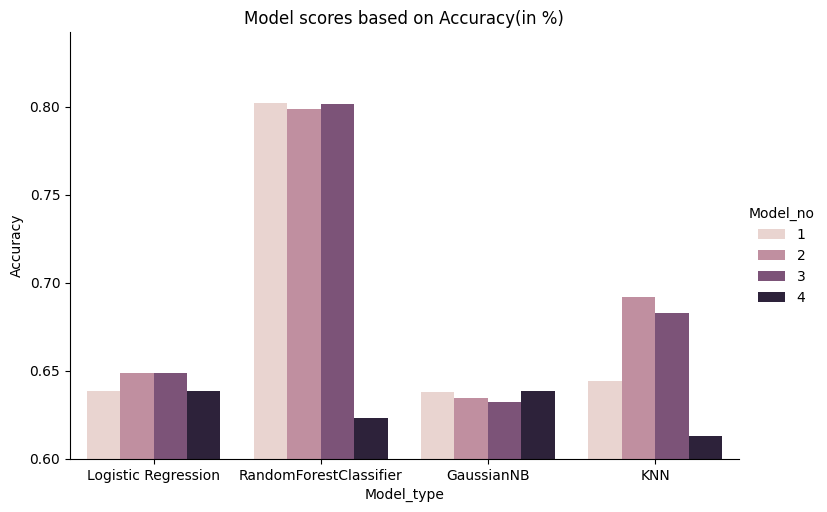

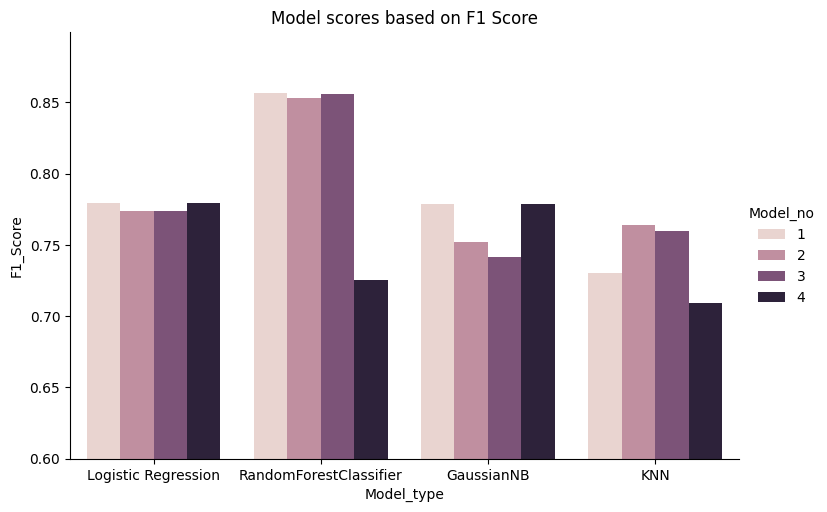

In [32]:
# fig=plt.Figure()
fig=sns.catplot(model_scores,y='Accuracy',x='Model_type',kind='bar',hue='Model_no',height=5,aspect=1.5).set(title='Model scores based on Accuracy(in %)')
fig2=sns.catplot(model_scores,y='F1_Score',x='Model_type',kind='bar',hue='Model_no',height=5,aspect=1.5).set(title='Model scores based on F1 Score')
fig.set(ylim=(0.6))
fig2.set(ylim=(0.6))

### Interpreting the results:
**Random forrest model** with all the features/independent variables in it's original state has the maximum accuracy (**80.2%**) and F1_Score (**0.856**).

Except the random forrest model with dimensions reduced to 2 using PCA, all the random forrest models performed well as compared to other models.

********************************
Let's perform grid search method on the best performing model and try to improve it's accuracy.


## Hypertuning the best model (Grid search)

Using the top model input (**Random Forest Classifier** with **all the features/independent variables in it's original state**), below we perform a grid search to identify the best parameters

#### Random Forest Classifier with all the features/independent variables in it's original state

In [33]:
# Creating the grid search parameters dict
grid_space={'max_depth':[3,5,10,None],
              'n_estimators':[10,100,200],}
# splitting the data into train test
X_train, X_test, y_train, y_test = train_test_split(x,y , test_size=0.33, random_state=42)
#creating a model object to be used 
clf = RandomForestClassifier()
#creating grid search object
GS_RF_model = GridSearchCV(clf, param_grid = grid_space,scoring = 'accuracy')
#fitting the data on the grid search
GS_RF_model.fit(X_train,y_train)
# predicting the test values
y_pred=GS_RF_model.predict(X_test)
# printing the accuracy score
print('Accuracy Score:'+str(accuracy_score(y_test,y_pred)))
#printing the confusion matrix
print('Confusion Matrix')
print(confusion_matrix(y_test,y_pred))
#printing the precision score
print('Precision Score:'+str(precision_score(y_test,y_pred)))
#printing the recall score
print('Recall Score:'+str(recall_score(y_test,y_pred)))
print('*************')

Accuracy Score:0.8031863791631084
Confusion Matrix
[[ 7807  5749]
 [ 1626 22290]]
Precision Score:0.7949641570669425
Recall Score:0.9320120421475163
*************


After performing the grid search the accuracy of the model increased by 0.1%. This is the best model so far in terms of accuracy and can be considered as our main model.
******************************
The best parameters found using grid search which produced the best model are:

In [106]:
#printing the best parameters found by grid search
GS_RF_model.best_params_

{'max_depth': None, 'n_estimators': 200}

## Saving the models to a pickle file

Below we'll save the best grid search model along with other algorithms best model for reusability in future.

In [36]:
# save the grid search random forrest model as a pickle file
model_pkl_file = "rfr_model_grid.pkl"  
with open(model_pkl_file, 'wb') as file:  
    pickle.dump(GS_RF_model, file)

# save the logistic regression model 3 as a pickle file
model_pkl_file = "lr_model_3.pkl"  
with open(model_pkl_file, 'wb') as file:  
    pickle.dump(LR_model_3, file)

# save the Naive bayes model 4 as a pickle file
model_pkl_file = "nb_model_4.pkl"  
with open(model_pkl_file, 'wb') as file:  
    pickle.dump(NB_model_4, file)

# save the KNN model 2 as a pickle file
model_pkl_file = "knn_model_2.pkl"  
with open(model_pkl_file, 'wb') as file:  
    pickle.dump(KNN_model_2, file)

## Example to Load the model and predicting value using the same

#### Below is a function which will predict the values of mode of the dataframe when in original form provided

In [92]:
# function to predict values using the saved model
def predict_value(model_file_name,dataframe,genre_dict):
    pickled_model = pickle.load(open(model_file_name, 'rb'))
    # Converting bool values from the explicit column to numerical values
    dataframe['explicit']=[int(i) for i in dataframe['explicit']]
    #converting the track_genre column to numerical values and storing the value equivalent in the genre_dict variable
    dataframe['track_genre']=[genre_dict.to_list().index(i) for i in dataframe['track_genre']]
    #taking the relevent columns for the model to predict
    dataframe=dataframe[['duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness',
    'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature','popularity','track_genre']]
    #predicting the values
    predicted=pickled_model.predict(dataframe)
    #returning the predicted values
    return list(predicted)

creating a sample dataframe from the original dataframe to use for predicting value by using the function created above 

In [93]:
# Slicing the original fataframe to create a small sample dataframe
sample=df[50:59]

In [94]:
#Viewing the sample dataframe
sample

,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
50,72xTsTouZ5nBmASX8k1XCW,Highland Peak,Trampoline (Acoustic),Trampoline - Acoustic,46,213098,False,0.596,0.200,0,-10.424,0,0.0305,0.9100,0.000183,0.0884,0.308,107.893,4,acoustic
51,3ILmwMefYZoQh5Cf5jeuUQ,Motohiro Hata,Documentary,透明だった世界,61,232360,False,0.373,0.914,0,-4.185,1,0.0565,0.0760,0.000000,0.6690,0.560,168.210,4,acoustic
52,2DHDuADAHoUW6n0z80RLQF,Andrew Belle,Black Bear,Pieces,60,241119,False,0.494,0.652,6,-5.863,0,0.0314,0.0754,0.002560,0.1250,0.298,137.018,4,acoustic
53,5JDcQAztvZTIkrWoZihgvC,Ron Pope,The Bedroom Demos,A Drop in the Ocean,68,220239,False,0.447,0.393,5,-8.650,1,0.0380,0.7850,0.000000,0.2800,0.564,73.139,3,acoustic
54,2sYFi9xVSZ56WHKSY2fN1K,Adam Christopher,So Far Away (Acoustic),So Far Away - Acoustic,52,171543,False,0.576,0.331,6,-9.389,0,0.0306,0.8940,0.000034,0.1290,0.407,149.020,4,acoustic
55,6xJOhSm4SvZwzy3uhWz26O,Andrew Belle,Black Bear,The Enemy,62,286865,False,0.536,0.890,1,-5.222,1,0.0375,0.0780,0.020200,0.1310,0.273,121.974,4,acoustic
56,7lLKxcNeJtDTWVRKHovLEC,Aron Wright,Build It Better,Build It Better,51,234473,False,0.526,0.333,4,-13.020,1,0.0314,0.9100,0.168000,0.1110,0.159,94.951,4,acoustic
57,25UzeaV47eDT44Fovve6xQ,Chord Overstreet,Sleepwalking in the Rain,Sleepwalking in the Rain,0,216000,False,0.501,0.381,0,-9.448,1,0.0360,0.6870,0.001330,0.1190,0.502,80.075,4,acoustic
58,4oa14QBfWRDfJy2agySy0L,Sara Bareilles,Little Voice,Gravity,67,232760,False,0.270,0.275,0,-10.357,1,0.0356,0.8340,0.000000,0.1460,0.231,168.964,4,acoustic


In [95]:
#Running the sample dataframe to predict the mode
predicted_values=predict_value('rfr_model_grid.pkl',sample,genre_dict)

In [102]:
#Checking the predicted values
print("Predicted values are:")
print(predicted_values)
#checking the original values
print('Original values are:')
print(list(sample['mode']))

Predicted values are:
[0, 1, 0, 1, 1, 1, 1, 1, 1]
Original values are:
[0, 1, 0, 1, 0, 1, 1, 1, 1]


In [105]:
#Checking the acuracy of the above
print('Accuracy Score of the above output is')
print(round(accuracy_score(predicted_values,list(sample['mode'])),2))

Accuracy Score of the above output is
0.89


## Recommendation
The above model and function is an example of how spotify can predict the mode of songs the user is listening in his session and find the most common mode to predict the next song which can help in keeping the emotion of the song similar as each mode is related to certain emotions.

This will help in increasing the accuracy of the song recommendation according to users current emotion and mood.

**Note**: 
- All accuracy scores are in the score range of 0 to 1. To calculate the percentage, it should be multiplied by 100.
  

## References
- **Chase, W. (2006).** How music really works! : the essential handbook for songwriters, performers, and music students. Vancouver: Roedy Black Pub.
- **Google Developers. (n.d.).** Imbalanced Data. [online] Available at: https://developers.google.com/machine-learning/data-prep/construct/sampling-splitting/imbalanced-data.
- **Pandya, M. (2023)**. README.md · maharshipandya/spotify-tracks-dataset at main. [online] huggingface.co. Available at: https://huggingface.co/datasets/maharshipandya/spotify-tracks-dataset/blob/main/README.md [Accessed 12 Mar. 2024].